<h1>Helvar Starter Kit</h1>
<h3>Welcome to Helvar's Junction Challenge!</h3>
<p>This notebook is to help you get acquainted with the dataset. You can follow the instructions to easily load and visualize datasets. However, this is only for convenience purposes. You are welcome to use whatever tools you are comfortable with, as we are only interested in results!</p>
<p>Let's Begin by first loading all necessary libraries for this notebook to run.</p>

In [5]:
%load_ext autoreload
%autoreload 2
import pandas as pd
import numpy as np
import base64
import imageio as iio
from plotting import Plotting
import plotly.graph_objects as go
from pyvis.network import Network

<p>This starter kit contains sample datafiles. You can also download the full datasets in the README document. Please remember to place the downloaded zip file in the data folder and unzip it.</p>
<ol>
<li>First load the pickle file and convert the timestamps to Helsinki timezone</li>
<li>Next load the json file containing deviceids</li>
<li>Finally load the png file as both a numpy array and a base64 encoded image. We need the later for plotting in Plotly helper functions</li>
</ol>

In [3]:
site = 'site_1'

In [6]:
df_events = pd.read_pickle(f'./data/{site}/{site}.pkl', compression='gzip')

In [7]:
df_events.loc[:, 'timestamp'] = (pd.to_datetime(df_events['timestamp'], utc=True)
                                 .dt.tz_convert('Europe/Helsinki')
                                 .dt.tz_localize(None))

In [8]:
print(df_events.head(20))
# sort by timestamp
df_events = df_events.sort_values(by='timestamp')


                    timestamp  deviceid
0  2021-06-27 14:18:04.530398        30
1  2021-06-27 14:18:37.952030        30
2  2021-06-27 14:23:31.079242        30
3  2021-06-27 14:24:02.759153        30
4  2021-06-27 14:24:40.095851        30
5  2021-06-27 14:25:20.690448        30
6  2021-06-27 14:30:30.654250        30
7  2021-06-27 14:31:09.464464        30
8  2021-07-12 20:06:38.021524        30
9  2021-07-12 20:07:18.622207        30
10 2021-07-12 20:12:37.354040        30
11 2021-07-12 20:13:17.421083        30
12 2021-07-12 20:30:34.217291        30
13 2021-07-12 20:31:15.832199        30
14 2021-06-08 21:43:06.940317        30
15 2021-06-08 21:43:47.111801        30
16 2021-06-08 21:48:45.749844        30
17 2021-06-08 21:49:26.868675        30
18 2021-06-08 21:53:57.976513        30
19 2021-06-08 21:54:31.122495        30


## Start custom solution

In [9]:
#Add hour, minute and second of the day to df
def datetime64_to_time_of_day(datetime64_array):
    """
    Return a new array. For every element in datetime64_array return the time of day (since midnight).
    >>> datetime64_to_time_of_day(np.array(['2012-01-02T01:01:01.001Z'],dtype='datetime64[ms]'))
    array([3661001], dtype='timedelta64[ms]')
    >>> datetime64_to_time_of_day(np.datetime64('2012-01-02T01:01:01.001Z','[ms]'))
    numpy.timedelta64(3661001,'ms')
    """
    day = datetime64_array.astype('datetime64[D]').astype(datetime64_array.dtype)
    time_of_day = datetime64_array - day
    return time_of_day
df_events['time_of_day'] = datetime64_to_time_of_day(df_events['timestamp'])
df_events['hour_of_day'] = df_events['time_of_day'] / np.timedelta64(1, 'h')

In [10]:
# Unique list of all sensors
sensor_names = df_events['deviceid'].unique()
len(sensor_names)

56

In [11]:
print(df_events.shape)
event_list = list(df_events.to_records(index=False))


(1558459, 4)


In [12]:
# Histogram of events per hour

timestamps = [datetime64_to_time_of_day(x[0])/(1e9*60*60) for x in event_list]
fig = go.Figure(data=[go.Histogram(x=timestamps)])
fig.show()

In [26]:

def get_edges(event_list, time_window_s='5'):
    edges = {}
    time_window = pd.Timedelta(f'{time_window_s}s')
    for i in range(len(event_list)):
        if i % 1000 == 0:
            print(i)
        event = event_list[i]
        timestamp = event[0]
        node = event[1]
        for j in range(i+1, len(event_list)):
            other_event = event_list[j]
            other_timestamp = other_event[0]
            other_node = other_event[1]
            if node == other_node:
                continue
            time_difference = other_timestamp - timestamp
            if time_difference > time_window:
                break
            # Check if other_timestamp is within time_window
            edgelist = edges.get((min(node, other_node), max(node, other_node)), [])
            edgelist.append(time_difference.astype(np.float32)/1e9)
            edges[(min(node, other_node), max(node, other_node))] = edgelist
    return edges

edges = get_edges(event_list)

0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000
87000
88000
89000
90000
91000
92000
93000
94000
95000
96000
97000
98000
99000
100000
101000
102000
103000
104000
105000
106000
107000
108000
109000
110000
111000
112000
113000
114000
115000
116000
117000
118000
119000
120000
121000
122000
123000
124000
125000
126000
127000
128000
129000
130000
131000
132000
133000
134000
135000
136000
137000
138000
139000
140000
141000
142000
143000
144000
145000
146000
147000
148000
149000
150000
151000
152000
153000
154000
155000
156000
157000
158000


In [55]:
i = 0
for key, values in edges.items():
    if key[0] == 17:
        print(key, len(values))
    i += 1

(17, 39) 578
(17, 45) 3511
(17, 37) 712
(17, 30) 1677
(17, 36) 722
(17, 40) 658
(17, 15) 4547
(17, 14) 4166
(17, 22) 1089
(17, 50) 831
(17, 0) 802
(17, 28) 920
(17, 27) 794
(17, 48) 1471
(17, 1) 684
(17, 29) 990
(17, 24) 1693
(17, 19) 990
(17, 11) 146
(17, 32) 1285
(17, 16) 1964
(17, 47) 1209
(17, 18) 514
(17, 46) 502
(17, 54) 1463
(17, 52) 1447
(17, 21) 939
(17, 33) 618
(17, 34) 997
(17, 49) 1444
(17, 41) 1212
(17, 35) 691
(17, 9) 224
(17, 31) 286
(17, 53) 1779
(17, 8) 1242
(17, 20) 378
(17, 51) 610
(17, 12) 767
(17, 44) 699
(17, 23) 791
(17, 42) 325
(17, 55) 229
(17, 10) 325
(17, 38) 309
(17, 13) 191
(17, 43) 453
(17, 3) 5
(17, 25) 8
(17, 6) 7
(17, 26) 7
(17, 2) 5
(17, 5) 5
(17, 7) 1
(17, 4) 1


In [27]:
edge_freq_list = [ (k, (len(v), np.median(v), np.std(v))) for k, v in edges.items() ]
len(edge_freq_list)

1533

In [74]:
# Histogram of standard deviations
sdtdevs = [v[2] for k, v in edge_freq_list]
fig = go.Figure(data=[go.Histogram(x=sdtdevs)])
fig.show()

In [94]:
# Histogram of number of events per pair of nodes
sdtdevs = [v[0] for k, v in edge_freq_list]
fig = go.Figure(data=[go.Histogram(x=sdtdevs, nbinsx=5000)])
fig.show()

In [69]:
# Histogram of distance for most common edge
sorted_edge_freq_list = sorted(edge_freq_list, key=lambda x: x[1][0], reverse=True)
most_common_edge = edge_freq_list[19][0]
edge_distances = edges[most_common_edge]
fig = go.Figure(data=[go.Histogram(x=edge_distances)])
fig.show()


In [104]:
# Discard edges where the std dev is larger than 0.5 of the std dev of the uniform distribution
stddev_uniform = time_window.seconds / np.sqrt(12)
print('len before', len(edge_freq_list))
edge_freq_list_filtered1 = [ (k, v) for (k, v) in edge_freq_list if v[2] < stddev_uniform * 0.8 ]
print('len after', len(edge_freq_list_filtered1))


len before 1533
len after 174


In [42]:
# Discard edges where the number of events is smaller than 100
print('len before', len(edge_freq_list))
edge_freq_list_filtered2 = [ (k, v) for (k, v) in edge_freq_list if v[0] > 8000 ]
print('len after', len(edge_freq_list_filtered2))

sdtdevs = [v[2] for k, v in edge_freq_list_filtered2]
fig = go.Figure(data=[go.Histogram(x=sdtdevs)])
fig.show()


len before 1533
len after 104


In [44]:
def get_network(edge_freq_list):
    net = Network()

    added_elements = []

    # for device in sensor_names:
    #     net.add_node(str(device))

    for element in edge_freq_list:
        node1, node2 = element[0]
        if node1 not in added_elements:
            net.add_node(str(node1), )
            added_elements.append(node1)
        if node2 not in added_elements:
            net.add_node(str(node2))
            added_elements.append(node2)
        strength = element[1][0]
        variance = round(element[1][2],2)
        distance = round(element[1][1],2)
        net.add_edge(str(node1), str(node2), value=element[1][0], length=distance*100)#, label=f"s:{strength},d: {distance},v: {variance}")

    net.show('network.html')

get_network(edge_freq_list_filtered2)

In [45]:
print(edges[(2, 45)])

KeyError: (2, 45)

## Attempt using only 6-8 AM, 11-12 AM, and 15-17 PM data

In [22]:
# Only Morning:
# print('prefilter', df_events.shape)
HOURSDATA = {}
for h in range(0, 24):

    df_events_morningfilter = df_events[(df_events['hour_of_day'] >= h) & (df_events['hour_of_day'] <= h + 1)]
    # print('postfilter', df_events_morningfilter.shape)
    event_list_morningfilter = list(df_events_morningfilter.to_records(index=False))

    edges_morningfilter = get_edges(event_list_morningfilter, 3)
    edge_freq_list_morningfilter = [ (k, (len(v), np.median(v), np.std(v))) for k, v in edges_morningfilter.items() ]
    #get_network(edge_freq_list_morningfilter)
    sorted_edge_freq_list_morningfilter = sorted(edge_freq_list_morningfilter, key=lambda x: x[1][0], reverse=True)
    HOURSDATA[h] = []
    for i in sorted_edge_freq_list_morningfilter[:30]:
        HOURSDATA[h].append(i[0])
print(HOURSDATA)


{0: [], 1: [], 2: [(10, 42), (8, 33), (33, 34), (33, 36), (34, 36), (8, 32), (8, 34), (22, 30), (22, 32), (8, 36), (50, 53), (32, 34), (22, 50), (8, 22), (22, 42), (32, 33), (51, 52), (42, 50), (10, 22), (32, 36), (51, 53), (30, 32), (8, 30), (30, 33), (30, 36), (30, 42), (22, 53), (30, 34), (32, 42), (22, 34)], 3: [(22, 30), (50, 53), (10, 42), (22, 50), (51, 53), (51, 52), (0, 28), (27, 28), (8, 32), (0, 27), (8, 33), (22, 53), (42, 50), (33, 34), (33, 36), (34, 36), (52, 54), (8, 34), (22, 51), (22, 42), (50, 51), (0, 10), (0, 42), (8, 36), (24, 54), (30, 52), (30, 53), (51, 54), (17, 45), (30, 42)], 4: [(33, 34), (8, 33), (33, 36), (34, 36), (22, 30), (8, 32), (8, 34), (10, 42), (50, 53), (22, 50), (8, 36), (22, 32), (51, 52), (51, 53), (0, 28), (27, 28), (32, 34), (0, 27), (22, 36), (52, 54), (32, 33), (22, 34), (24, 54), (8, 22), (29, 30), (37, 39), (42, 50), (22, 53), (38, 40), (30, 50)], 5: [(29, 30), (33, 34), (8, 33), (10, 42), (33, 36), (34, 36), (22, 30), (8, 32), (8, 34), 

In [223]:
# Attempt using only 6-8 AM, 11-12 AM, and 15-17 PM data
print('prefilter', df_events.shape)
df_events_hourfilter = df_events[(df_events['hour_of_day'] >= 6) & (df_events['hour_of_day'] <= 8) | (df_events['hour_of_day'] >= 11) & (df_events['hour_of_day'] <= 12) | (df_events['hour_of_day'] >= 15) & (df_events['hour_of_day'] <= 17)]
print('postfilter', df_events_hourfilter.shape)
event_list_hourfilter = list(df_events_hourfilter.to_records(index=False))

edges_hourfilter = get_edges(event_list_hourfilter, 3)
edge_freq_list_hourfilter = [ (k, (len(v), np.median(v), np.std(v))) for k, v in edges_hourfilter.items() ]
get_network(edge_freq_list_hourfilter)

prefilter (1558459, 4)
postfilter (461427, 4)
0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000
87000
88000
89000
90000
91000
92000
93000
94000
95000
96000
97000
98000
99000
100000
101000
102000
103000
104000
105000
106000
107000
108000
109000
110000
111000
112000
113000
114000
115000
116000
117000
118000
119000
120000
121000
122000
123000
124000
125000
126000
127000
128000
129000
130000
131000
132000
133000
134000
135000
136000
137000
138000
139000
140000
141000
142000
143000
144000
145000
146000
147000
148000
149000
150000
151000
152

In [133]:
sorted_edge_freq_list_hourfilter = sorted(edge_freq_list_hourfilter, key=lambda x: x[1][0], reverse=True)

get_network(sorted_edge_freq_list_hourfilter[:100])

## Now checking connection when going through third node
The logic here is to find and remove edges that connect nodes that actually have a node in between. Say in reality the path is A->B->C, then we want to have edges A->B and B->C. We want to remove the edge A->C. Maybe we can do this by, given a pair of nodes X and Y, we check if we have an edges X->Z and Z->Y with similar strenght, and the distance matches. If so, we remove X->Y. 

In [224]:

def get_edges_path(event_list, time_window_s=5, node_chain_length=2):

    edges = {}
    time_window = pd.Timedelta(f'{time_window_s}s')
    for i in range(len(event_list)):
        if i % 1000 == 0:
            print(i)
        event = event_list[i]
        timestamp = event[0]
        node_id = event[1]
        prev_node_id = node_id
        node_chain = [(node_id, timestamp)]

        for j in range(i+1, len(event_list)):
            if len(node_chain) >= node_chain_length:
                break
            other_event = event_list[j]
            other_timestamp = other_event[0]
            other_node = other_event[1]
            if prev_node_id == other_node:
                continue
            time_difference = other_timestamp - timestamp
            if time_difference > time_window:
                break
            node_chain.append((other_node, other_timestamp))
            prev_node_id = other_node
        

            

    return edges

edges = get_edges(event_list)

0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000


KeyboardInterrupt: 

## Multidimensional Scaling approach

In [135]:
import numpy as np

from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection

from sklearn import manifold
from sklearn.metrics import euclidean_distances
from sklearn.decomposition import PCA

In [144]:
# Fake data
EPSILON = np.finfo(np.float32).eps
n_samples = 20
seed = np.random.RandomState(seed=3)
X_true = seed.randint(0, 20, 2 * n_samples).astype(float)
X_true = X_true.reshape((n_samples, 2))
# Center the data
X_true -= X_true.mean()

similarities = euclidean_distances(X_true)

# Add noise to the similarities
noise = np.random.rand(n_samples, n_samples)
noise = noise + noise.T
noise[np.arange(noise.shape[0]), np.arange(noise.shape[0])] = 0
similarities += noise


[[ 1.45 -5.55]
 [-0.55 -8.55]
 [10.45  1.45]
 [ 2.45  0.45]
 [ 1.45 -2.55]
 [-8.55  3.45]
 [-1.55  5.45]
 [ 8.45 -6.55]
 [-6.55 -7.55]
 [10.45 -3.55]
 [-0.55  5.45]
 [-7.55  1.45]
 [-1.55  2.45]
 [-7.55  6.45]
 [ 7.45 -3.55]
 [ 8.45  5.45]
 [-8.55 -8.55]
 [ 0.45  9.45]
 [-3.55 -1.55]
 [-3.55  5.45]]


In [238]:
# Real data
matrix_size = len(sensor_names)
#Generate empty matrix of size matrix_size
similarities = np.zeros((matrix_size, matrix_size))
similarities[:] = np.nan
# Set the diagonal to 0
for i in range(len(sensor_names)):
   similarities[i,i] = 0

# edge_freq_list: all edges
# edge_freq_list_hourfilter: only includes events that occur in 6-8 AM, 11-12 AM, and 15-17 PM
for i in range(len(edge_freq_list_hourfilter)):
    if i % 100 == 0:
        print(i)
    edge = edge_freq_list[i]
    node1 = edge[0][0]
    node2 = edge[0][1]
    strength = edge[1][0]
    distance = edge[1][1]
    variance = edge[1][2]
    if strength > 100:
        similarities[node1][node2] = distance
        similarities[node2][node1] = distance


0
100
200
300
400
500
600
700
800
900
1000
1100
1200


In [241]:
# similarities is a distance matrix, but it has NaN values where there is no edge
# We want to estimate the distance between nodes that have missing edges.
# We know the coordinates fit in a 2D space.
# We can use the MDS algorithm to estimate the distance between nodes that have missing edges.
# manifold.MDS can't handle NaN values, so

pos = manifold.MDS(n_components=2, dissimilarity="precomputed", random_state=6).fit_transform(similarities)


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [229]:
print(similarities)

[[0.         2.04753203 0.         ... 2.40465408 2.5178071  2.56110106]
 [2.04753203 0.         0.         ... 2.3684329  2.89359706 2.6603671 ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [2.40465408 2.3684329  0.         ... 0.         2.95394995 2.41301402]
 [2.5178071  2.89359706 0.         ... 2.95394995 0.         3.00973491]
 [2.56110106 2.6603671  0.         ... 2.41301402 3.00973491 0.        ]]


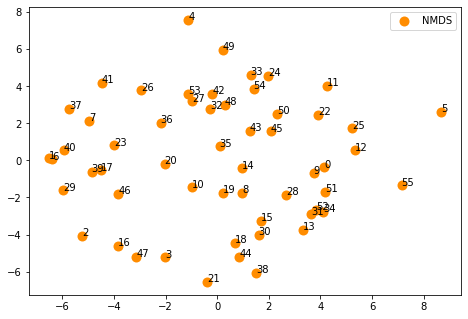

In [232]:
# Do MDS

# mds = manifold.MDS(
#     n_components=2,
#     max_iter=30000,
#     eps=1e-9,
#     random_state=seed,
#     dissimilarity="precomputed",
#     n_jobs=1,
# )
# pos = mds.fit(similarities).embedding_

nmds = manifold.MDS(
    n_components=2,
    metric=False,
    max_iter=3000,
    eps=1e-12,
    dissimilarity="precomputed",
    random_state=seed,
    n_jobs=1,
)
npos = nmds.fit(similarities).embedding_
# npos = nmds.fit_transform(similarities)

# Rescale the data
# pos *= np.sqrt((X_true ** 2).sum()) / np.sqrt((pos ** 2).sum())
npos *= np.sqrt((X_true ** 2).sum()) / np.sqrt((npos ** 2).sum())

# Rotate the data
clf = PCA(n_components=2)

# pos = clf.fit_transform(pos)

npos = clf.fit_transform(npos)

fig = plt.figure(1)
ax = plt.axes([0.0, 0.0, 1.0, 1.0])

s = 100
# plt.scatter(pos[:, 0], pos[:, 1], color="turquoise", s=s, lw=0, label="MDS")
plt.scatter(npos[:, 0], npos[:, 1], color="darkorange", s=s, lw=0, label="NMDS")
plt.legend(scatterpoints=1, loc="best", shadow=False)

for i, label in enumerate(sensor_names):
    plt.annotate(label, npos[i])

similarities_2 = similarities.max() / (similarities + EPSILON) * 100
np.fill_diagonal(similarities_2, 0)
# Plot the edges
start_idx, end_idx = np.where(npos)
# a sequence of (*line0*, *line1*, *line2*), where::
#            linen = (x0, y0), (x1, y1), ... (xm, ym)
values = np.abs(similarities_2)

plt.show()

In [169]:
print(pos)

[[-1.51831513e+00 -1.73209367e-03]
 [-1.51831555e+00 -1.73223490e-03]
 [ 1.09587351e+01 -5.41608116e+00]
 [ 4.79322906e+00 -1.16130122e+01]
 [ 1.09493506e+01  5.43855715e+00]
 [ 8.66148051e+00  8.80460593e+00]
 [ 8.68500774e+00 -8.77872573e+00]
 [ 1.20263876e+01  1.84073955e+00]
 [-1.51831508e+00 -1.73190607e-03]
 [-2.42889775e+00 -5.05108725e-03]
 [-1.51831520e+00 -1.73173810e-03]
 [-8.72657969e-01 -2.53964162e+00]
 [-1.51831519e+00 -1.73230373e-03]
 [-1.16176374e+00 -1.76090038e+00]
 [-1.51831541e+00 -1.73253099e-03]
 [-1.51831569e+00 -1.73220814e-03]
 [-1.51831540e+00 -1.73177903e-03]
 [-1.09044387e+00  8.05692645e-01]
 [-1.51831525e+00 -1.73251773e-03]
 [-1.51831538e+00 -1.73216877e-03]
 [-1.63052962e+00  5.18091182e-01]
 [-1.51831540e+00 -1.73236545e-03]
 [-1.51831536e+00 -1.73195681e-03]
 [-1.51831551e+00 -1.73197829e-03]
 [-1.51831531e+00 -1.73241090e-03]
 [ 1.20285496e+01 -1.82259821e+00]
 [ 4.75339641e+00  1.16306184e+01]
 [-1.51831547e+00 -1.73225006e-03]
 [-1.51831517e+00 -1

## SVD

In [253]:
import random
import scipy.sparse as ss

n1, n2, r = 100, 100, 10
m = r*(n1+n2-r);
M = np.random.random((n1,r)).dot(np.random.random((r,n2)))
ind = random.sample(range(n1*n2),m)
Omega = np.unravel_index(ind, (n1,n2))
data = M[Omega]
P_Omega_M = ss.csr_matrix((data,Omega),shape = (n1,n2))

In [254]:
# print(m)
# print(M)
np.random.random((n1,r))


array([[0.7103988 , 0.56940697, 0.71422273, 0.02726562, 0.64902661,
        0.99711754, 0.87177731, 0.88194885, 0.66389816, 0.40345829],
       [0.19415422, 0.14264803, 0.84555942, 0.47930354, 0.12795893,
        0.92320857, 0.11702994, 0.49710207, 0.02305134, 0.61760408],
       [0.95129374, 0.28680419, 0.04599171, 0.01577927, 0.95912281,
        0.63168971, 0.14884422, 0.90233534, 0.24110668, 0.75841073],
       [0.03505292, 0.82403821, 0.58817807, 0.76980975, 0.7612328 ,
        0.59563148, 0.57541641, 0.20777409, 0.05014139, 0.67096709],
       [0.22162968, 0.14861277, 0.37549283, 0.50485131, 0.76737866,
        0.79909437, 0.16655802, 0.82650909, 0.3080055 , 0.65438623],
       [0.13502281, 0.41420957, 0.05441291, 0.18689006, 0.17616509,
        0.48980875, 0.68311555, 0.18960287, 0.86691408, 0.44683557],
       [0.17058441, 0.11632719, 0.82213398, 0.30234129, 0.20603375,
        0.88132989, 0.2015523 , 0.49279123, 0.60623079, 0.78700938],
       [0.73772577, 0.65615633, 0.7831840

## End custom solution

In [203]:
df_devices = pd.read_json(f'./data/{site}/{site}.json')

In [204]:
df_devices.head(5)

,deviceid,x,y
0,0,3184.386414,1747.747751
1,1,1024.464981,1497.403100
2,2,1016.179219,1770.943189
3,3,2225.189496,1973.607200
4,4,2513.143107,1925.670073


In [205]:
with open(f'./data/{site}/{site}.png', "rb") as image_file:
    encoded_string = base64.b64encode(image_file.read()).decode()

In [206]:
img = iio.imread(f'./data/{site}/{site}.png')
img.shape

(2635, 5270, 4)

We can now load the floorplan just to get a feel of what the devices look like.

In [207]:
scaling_factor = 3 # Set to 1 for highest resolution
plotting_obj = Plotting(bg_img=encoded_string, dims=(img.shape[1], img.shape[0]), df_devices=df_devices, scaling_factor=scaling_factor)
plotting_obj.run(renderer='browser') # Switch to iframe if you would like to view it here

## View Occupancy by Day
<p>Since we are dealing with irregular IoT event data, we need to define our time-series window size and compute a statistic for the events during that window. This example shows the sum of events per day. </p>

In [15]:
df_events_day = df_events.copy()
df_events_day.loc[:, 'timestamp'] = df_events_day['timestamp'].dt.floor('1D')
df_events_day.loc[:, 'value'] = 1.0
df_events_day = df_events_day.groupby('timestamp').sum()
df_events_day = df_events_day.drop(['deviceid'], axis=1)
df_events_day = df_events_day.reindex(pd.date_range(df_events_day.index.min(), df_events_day.index.max(), freq='1D')).fillna(0)

In [16]:
df_events_day.head(5)

,value
2021-05-05,24422.0
2021-05-06,27866.0
2021-05-07,25084.0
2021-05-08,950.0
2021-05-09,1418.0


In [210]:
fig = go.Figure(data=[go.Scatter(x=df_events_day.index, y=df_events_day['value'])],
                layout=dict(height=500, width=1000))
fig.show()

NameError: name 'df_events_day' is not defined

## Animate Data

<p>The plotting helper script contains an animation engine utilising Plotly. It is extremely simple to use. Here is an example where we aggregate data into 5 minute bins, and then visualize how motion sensors are triggered through 1 day. You can choose different time intervals, but please remember that higher time granularities can end up rendering a lot of frames and might lead to performance issues. In this example, the total number of frames is (60//5) * 24 = 288</p>

In [33]:
df_events_day = df_events[df_events.timestamp.dt.date.astype(str) == "2021-08-05"].copy()
df_events_day.timestamp = df_events_day.timestamp.dt.floor('1min')
df_events_day.loc[:, 'b'] = 1
df_events_day = df_events_day.groupby(['deviceid', 'timestamp']).sum()
df_events_day = df_events_day.pivot_table(index='timestamp', columns='deviceid', values='b')
df_events_day = df_events_day.reindex(pd.date_range(df_events_day.index.min().floor('1D'), df_events_day.index.max().ceil('1D'), freq='1min', closed='left')).fillna(0)

In [34]:
frames = df_events_day.to_dict(orient='records')
ts = df_events_day.reset_index()[['index']].astype(str).to_dict(orient='records')

In [35]:
df_events_day[df_events_day[0] > 0]


deviceid,0,1,8,9,10,11,12,13,14,15,...,46,47,48,49,50,51,52,53,54,55
2021-08-05 06:06:00,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 06:07:00,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 06:13:00,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 06:14:00,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 06:16:00,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-05 21:28:00,2.0,2.0,0.0,0.0,2.0,2.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 21:29:00,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 21:30:00,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-08-05 21:44:00,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [36]:
plotting_obj = Plotting(bg_img=encoded_string, dims=(img.shape[1], img.shape[0]), df_devices=df_devices, scaling_factor=3)
plotting_obj.populate_data(frames, ts)
plotting_obj.run(renderer='browser')

## Challenge Category 1
<p>For the first challenge, we want to solve a real-world problem of indoor device mapping. The floorplans we have provided you with already contain mapped devices, meaning they have defined locations on a floorplan. In reality, this takes a lot of time. We physically need to identify each device inside the building and place them on a floorplan. The objective of this exercise is to come up with ways to speed up this process. We have written down some ideas below, however feel free to be creative! You can come up with entirely new ideas of your own.</p>

#### Example Aproach:
<p>Let's assume the floorplan contains 500 devices. We can delete 400 devices, and use the occupancy events data to identify neighbours. Once the neighbours have been identified, we can simply use the data to locate the missing 400 devices! This means our engineers only need to locate 100 devices, and let the system run for N days and then find the rest.</p> 
<p>The Machine Learning aspect of the challenge comes from: 1. increasing the number of deleted devices, and 2. the smallest possible value of N that gives the best mappings. You can use Euclidean distance between the predicted location of the object and the actual location from our provided floorplans to determine accuracy of your algorithm. We have provided 5 different sites with a variety of device configurations and data, so be sure to properly create Training and Test Datasets!</p>


## Challenge Category 2
<p>The second challenge is more about providing value to the client. We have provided data from real-world buildings. These buildings are occupied according to certain predictable patterns. For example a school might only observe occupancy during the morning. A hospital or a shopping mall might observe occupancy throughout the day. The objective of this exercise is to determine how people move through buildings by combining spatial and temporal data. </p>

#### Example Aproach:
<p>We can define a graph network of devices, with the edge weights representing the distance between devices. Then depending on the proximity of devices and the correlation of events within a certain time-window, say 15 minutes, we can cluster the most frequently visited spaces in a building. By creating similar sequences across the day, week or month we can determine patterns that show us how the building is used at different times of the day, or different days of the week etc. We can also try to figure out which paths are dominant and which are used least frequently. Such information is extremely valuable to building owners and tenants.</p> 
<p>You can experiment with different windowing approaches. Try to think about what sort of metrics are important. Is it really worth investigaing how the occupancy changes at midnight, or is it worth understanding how people move through the building at 9AM? Also, does the pattern change during the week, for example do more people visit on Monday or Friday?</p>
<p>We would love to see your ideas on what is the best way to present the results of this type of data analysis to the customers. UI/UX experts, we're looking at you!</p>


## Challenge Category 3
<p>The last challenge is related to a type of sensor that is not common in smart buildings at the moment: audio sensors. We have availabe motion sensors that generate occupancy data, but we decided to augmnet that with audio data. We want to explore the utility of incorporating more data sources in a smart building.</p>
<p>The data collection is done at a garage, and contains 4 audio sensors placed in a rectangular grid. There is a lot of activity happening in the garage: people are walking, driving their car, or bicycles. The objective would be to identify these events by combining the audio streams from all the 4 sensors and by incorporating motion data to pinpoint where the activity was taking place.</p>

#### Example Aproach:
<p>This is an extremely open ended challenge. There are numerous ways this can be tackled. Clever audio signal processing, or using deep learning to detect events. The choice is yours.</p> 